# CMPINF 2100: Project Proposal 
## Tidy Tuesday: Spotify Songs
### Project Goal: Predict a song's popularity based on the features associated with a song

### PART A: Motivation


#### Personal Interest:
- Spotify is an application that I use on a daily basis from listesning songs to podcasts. Predicting song popularity has practical applications for artists, record labels, and music platforms. It will be interesting to see how this is implemented in the real-world where I can get a hands-on experience.

- Industries look for projects that solve or deal with real-world applications, I wish to pursue a career in data science & engineering and this project would be a great add-on to my portfolio.

#### Real-world Dataset:

- I saw the dataset and it provides a wide range of features, from musical characteristics like danceability and energy to textual information about tracks and albums. The richness of the data would allow exploratory data analysis and modeling.

- Also, the dataset have complexities in terms of data cleaning. Working with a real-world dataset with its own set of challenges was appealing.

#### Exploration and Modelling:

- The project involves regression analysis, which is a fundamental skill in data science. I wanted to strengthen my regression modeling skills and understand how different musical features contribute to a song's popularity.

- Also, the project provides readily available data and resources, which is helpful for learning and implementing data analysis techniques.

### PART B: Predictive modeling discussion

#### Data Dictionary 
This is from the `Tidy Tuesday Github` repo. The following dataset has songs from 6 main genres/categories `(EDM, Latin, Pop, R&B, Rap, & Rock)`.

| variable	| class	| description |
| --- | --- | --- |
| track_id | character | Song unique ID |
| track_name | character | Song Name |
| track_artist | character | Song Artist |
| track_popularity | double | Song Popularity (0-100) where higher is better |
| track_album_id | character | Album unique ID |
| track_album_name | character | Song album name |
| track_album_release_date | character | Date when album released |
| playlist_name | character | Name of playlist |
| playlist_id | character | Playlist ID |
| playlist_genre | character | Playlist genre |
| playlist_subgenre | character | Playlist subgenre |
| danceability | double | Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable. |
| energy | double | Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale. Perceptual features contributing to this attribute include dynamic range, perceived loudness, timbre, onset rate, and general entropy. |
| key | double | The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on. If no key was detected, the value is -1. |
| loudness | double | The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks. Loudness is the quality of a sound that is the primary psychological correlate of physical strength (amplitude). Values typical range between -60 and 0 db. |
| mode | double | Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0. |
| speechiness | double | Speechiness detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks. |
| acousticness | double | A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic. |
| instrumentalness | double | Predicts whether a track contains no vocals. "Ooh" and "aah" sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly "vocal". The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content. Values above 0.5 are intended to represent instrumental tracks, but confidence is higher as the value approaches 1.0. |
| liveness | double | Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live. |
| valence | double | A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry). |
| tempo | double | The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration. |
| duration_ms | double | Duration of song in milliseconds |


#### Problem Type:
- This is a `REGRESSION` problem as we aim to predict the numerical variable `track_popularity` on a scale from 0 to 100 since we are predicting a continuous numerical value rather than assigning songs to discrete categories, which would have been a classification problem.
- The quantity to predict is the "track_popularity" which is a numerical variable representing the song's popularity on a scale from 0 to 100, where higher values indicate greater popularity. 
- The goal is to build a predictive model that can estimate a song's popularity based on the given features like danceability, energy, key, loudness, mode, speechiness, and others.

#### Input Variables:

The following are the `input variables` that I have identified from the dataset-
- danceability
- energy
- key
- loudness
- mode
- speechiness
- acousticness
- instrumentalness
- liveness
- valence
- tempo
- duration_ms
- playlist_genre
- playlist_subgenre

#### Output variable:
- The response or output variable is `track_popularity` which represents the popularity of a song. It is a numerical variable ranging from 0 to 100, where higher values indicate a greater popularity.
- Since the response variable, "track_popularity" is available in the dataset we do not need any summary action or derivation.

#### Identifier variables:
The following variables are identifiers and should NOT be used in the models-
- track_id
- track_name
- track_artist
- track_album_id
- track_album_name
- track_album_release_date
- playlist_name
- playlist_id

### Part C) Exploratory Data Analysis - General Requirements

#### Import required packages

In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

#### Load data into pandas dataframe

In [286]:
songs_url = 'https://raw.githubusercontent.com/rfordatascience/tidytuesday/master/data/2020/2020-01-21/spotify_songs.csv'

In [287]:
df = pd.read_csv(songs_url)

In [288]:
df.head(5)

,track_id,track_name,track_artist,track_popularity,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,6f807x0ima9a1j3VPbc7VN,I Don't Care (with Justin Bieber) - Loud Luxur...,Ed Sheeran,66,2oCs0DGTsRO98Gh5ZSl2Cx,I Don't Care (with Justin Bieber) [Loud Luxury...,2019-06-14,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,6,-2.634,1,0.0583,0.1020,0.000000,0.0653,0.518,122.036,194754
1,0r7CVbZTWZgbTCYdfa2P31,Memories - Dillon Francis Remix,Maroon 5,67,63rPSO264uRjW1X5E6cWv6,Memories (Dillon Francis Remix),2019-12-13,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,11,-4.969,1,0.0373,0.0724,0.004210,0.3570,0.693,99.972,162600
2,1z1Hg7Vb0AhHDiEmnDE79l,All the Time - Don Diablo Remix,Zara Larsson,70,1HoSmj2eLcsrR0vE9gThr4,All the Time (Don Diablo Remix),2019-07-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-3.432,0,0.0742,0.0794,0.000023,0.1100,0.613,124.008,176616
3,75FpbthrwQmzHlBJLuGdC7,Call You Mine - Keanu Silva Remix,The Chainsmokers,60,1nqYsOef1yKKuGOVchbsk6,Call You Mine - The Remixes,2019-07-19,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,7,-3.778,1,0.1020,0.0287,0.000009,0.2040,0.277,121.956,169093
4,1e8PAfcKUYoKkxPhrHqw4x,Someone You Loved - Future Humans Remix,Lewis Capaldi,69,7m7vv9wlQ4i0LFuJiE2zsQ,Someone You Loved (Future Humans Remix),2019-03-05,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,...,1,-4.672,1,0.0359,0.0803,0.000000,0.0833,0.725,123.976,189052


#### Perform ESSENTIAL exploration tasks

In [283]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32833 entries, 0 to 32832
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   track_id                  32833 non-null  object 
 1   track_name                32828 non-null  object 
 2   track_artist              32828 non-null  object 
 3   track_popularity          32833 non-null  int64  
 4   track_album_id            32833 non-null  object 
 5   track_album_name          32828 non-null  object 
 6   track_album_release_date  32833 non-null  object 
 7   playlist_name             32833 non-null  object 
 8   playlist_id               32833 non-null  object 
 9   playlist_genre            32833 non-null  object 
 10  playlist_subgenre         32833 non-null  object 
 11  danceability              32833 non-null  float64
 12  energy                    32833 non-null  float64
 13  key                       32833 non-null  int64  
 14  loudne

In [18]:
df.shape

(32833, 23)

In [19]:
df.columns

Index(['track_id', 'track_name', 'track_artist', 'track_popularity',
       'track_album_id', 'track_album_name', 'track_album_release_date',
       'playlist_name', 'playlist_id', 'playlist_genre', 'playlist_subgenre',
       'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo',
       'duration_ms'],
      dtype='object')

In [21]:
df.dtypes

track_id                     object
track_name                   object
track_artist                 object
track_popularity              int64
track_album_id               object
track_album_name             object
track_album_release_date     object
playlist_name                object
playlist_id                  object
playlist_genre               object
playlist_subgenre            object
danceability                float64
energy                      float64
key                           int64
loudness                    float64
mode                          int64
speechiness                 float64
acousticness                float64
instrumentalness            float64
liveness                    float64
valence                     float64
tempo                       float64
duration_ms                   int64
dtype: object

In [22]:
df.dtypes.value_counts()

object     10
float64     9
int64       4
dtype: int64

In [23]:
df.nunique()

track_id                    28356
track_name                  23449
track_artist                10692
track_popularity              101
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
danceability                  822
energy                        952
key                            12
loudness                    10222
mode                            2
speechiness                  1270
acousticness                 3731
instrumentalness             4729
liveness                     1624
valence                      1362
tempo                       17684
duration_ms                 19785
dtype: int64

In [40]:
df.select_dtypes(exclude='number').nunique()

track_id                    28356
track_name                  23449
track_artist                10692
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
dtype: int64

In [34]:
df.select_dtypes(include='number').nunique()

track_popularity      101
danceability          822
energy                952
key                    12
loudness            10222
mode                    2
speechiness          1270
acousticness         3731
instrumentalness     4729
liveness             1624
valence              1362
tempo               17684
duration_ms         19785
dtype: int64

In [24]:
df.isna().sum()

track_id                    0
track_name                  5
track_artist                5
track_popularity            0
track_album_id              0
track_album_name            5
track_album_release_date    0
playlist_name               0
playlist_id                 0
playlist_genre              0
playlist_subgenre           0
danceability                0
energy                      0
key                         0
loudness                    0
mode                        0
speechiness                 0
acousticness                0
instrumentalness            0
liveness                    0
valence                     0
tempo                       0
duration_ms                 0
dtype: int64

`track_name`, `track_artist` and `track_album_name` have missing values in them.

In [30]:
df.describe(exclude='object')

,track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
count,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000,32833.000000
mean,42.477081,0.654850,0.698619,5.374471,-6.719499,0.565711,0.107068,0.175334,0.084747,0.190176,0.510561,120.881132,225799.811622
std,24.984074,0.145085,0.180910,3.611657,2.988436,0.495671,0.101314,0.219633,0.224230,0.154317,0.233146,26.903624,59834.006182
min,0.000000,0.000000,0.000175,0.000000,-46.448000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4000.000000
25%,24.000000,0.563000,0.581000,2.000000,-8.171000,0.000000,0.041000,0.015100,0.000000,0.092700,0.331000,99.960000,187819.000000
50%,45.000000,0.672000,0.721000,6.000000,-6.166000,1.000000,0.062500,0.080400,0.000016,0.127000,0.512000,121.984000,216000.000000
75%,62.000000,0.761000,0.840000,9.000000,-4.645000,1.000000,0.132000,0.255000,0.004830,0.248000,0.693000,133.918000,253585.000000
max,100.000000,0.983000,1.000000,11.000000,1.275000,1.000000,0.918000,0.994000,0.994000,0.996000,0.991000,239.440000,517810.000000


### Marginal Distribution for Categorical Variables

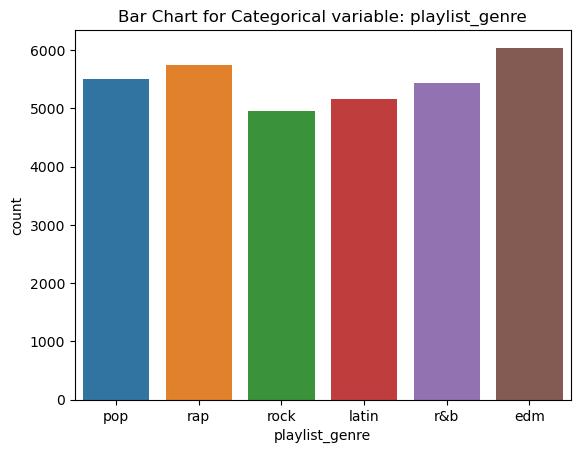

In [41]:
sns.countplot(data=df, x='playlist_genre')
plt.title('Bar Chart for Categorical variable: playlist_genre')
plt.show()

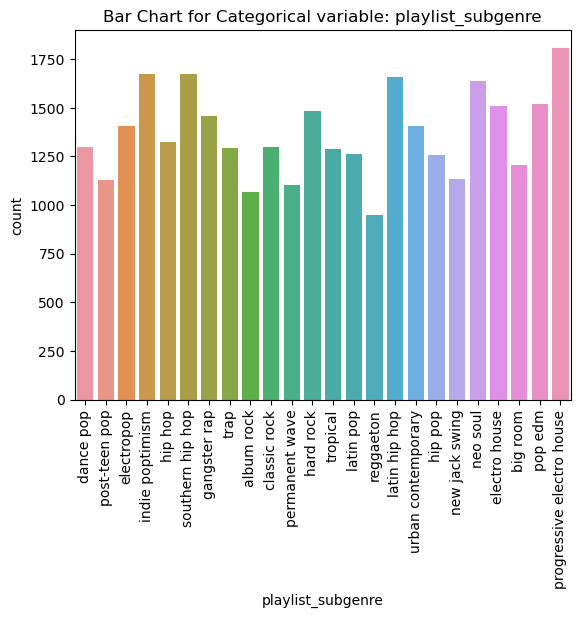

In [47]:
sns.countplot(data=df, x='playlist_subgenre')
plt.title('Bar Chart for Categorical variable: playlist_subgenre')
plt.xticks(rotation=90)
plt.show()

### Marginal Distribution for Continous Variables

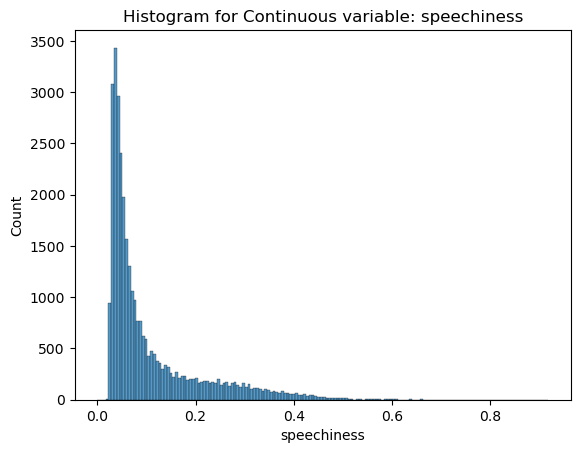

In [80]:
sns.histplot(data=df, x='speechiness')
plt.title('Histogram for Continuous variable: speechiness')
plt.show()

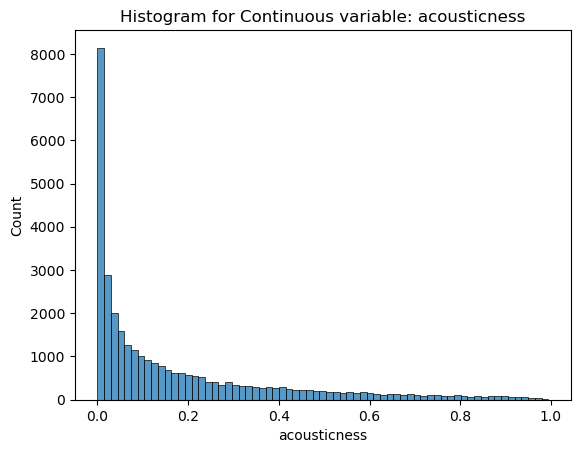

In [81]:
sns.histplot(data=df, x='acousticness')
plt.title('Histogram for Continuous variable: acousticness')
plt.show()

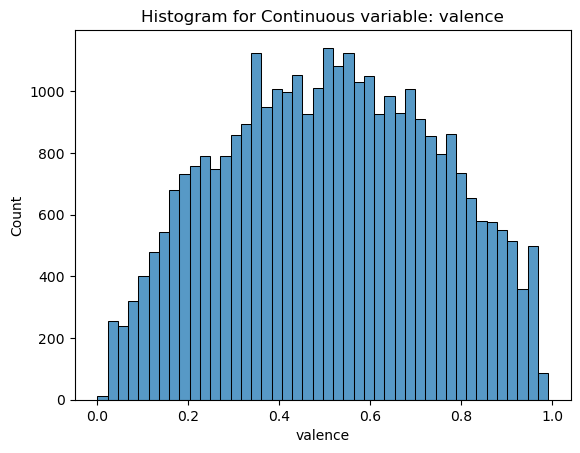

In [84]:
sns.histplot(data=df, x='valence')
plt.title('Histogram for Continuous variable: valence')
plt.show()

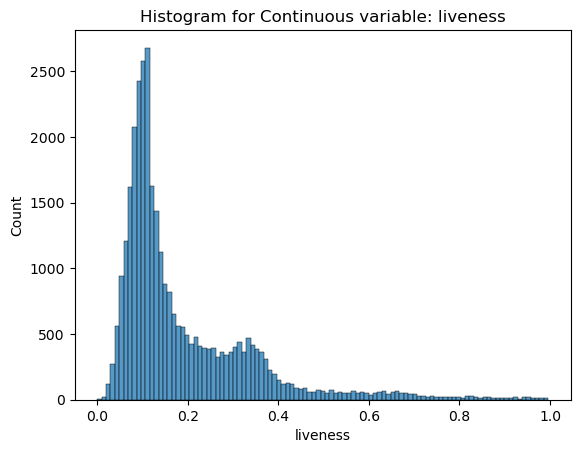

In [83]:
sns.histplot(data=df, x='liveness')
plt.title('Histogram for Continuous variable: liveness')
plt.show()

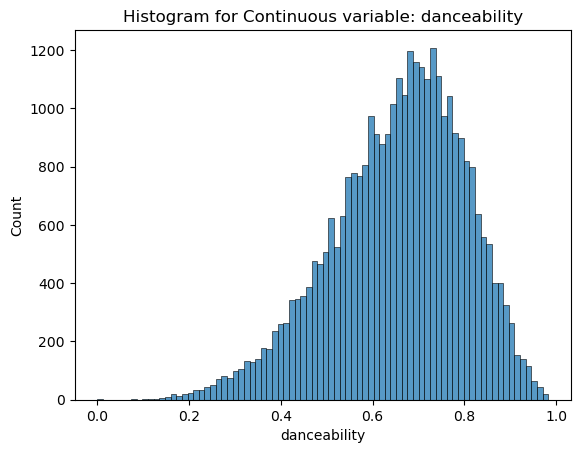

In [52]:
sns.histplot(data=df, x='danceability')
plt.title('Histogram for Continuous variable: danceability')
plt.show()

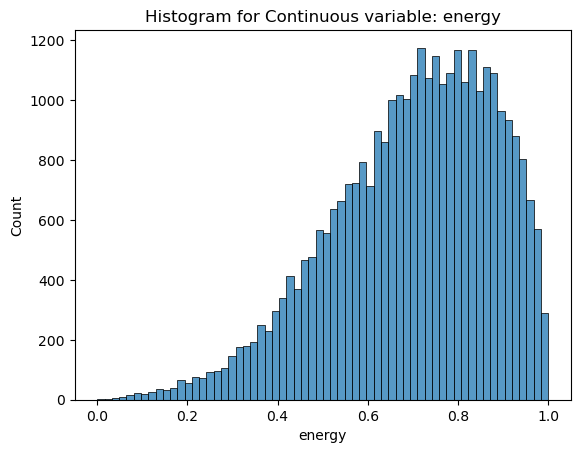

In [53]:
sns.histplot(data=df, x='energy')
plt.title('Histogram for Continuous variable: energy')
plt.show()

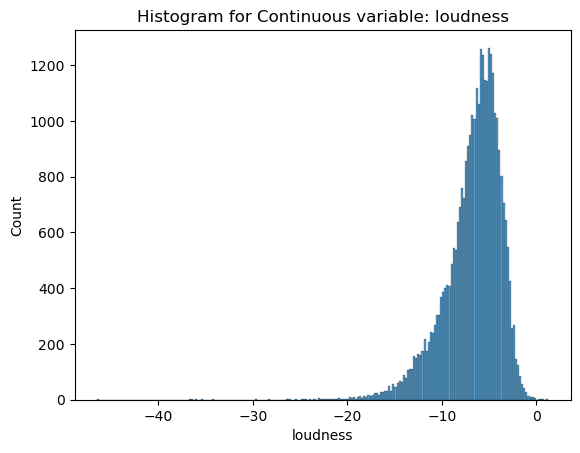

In [56]:
sns.histplot(data=df, x='loudness')
plt.title('Histogram for Continuous variable: loudness')
plt.show()

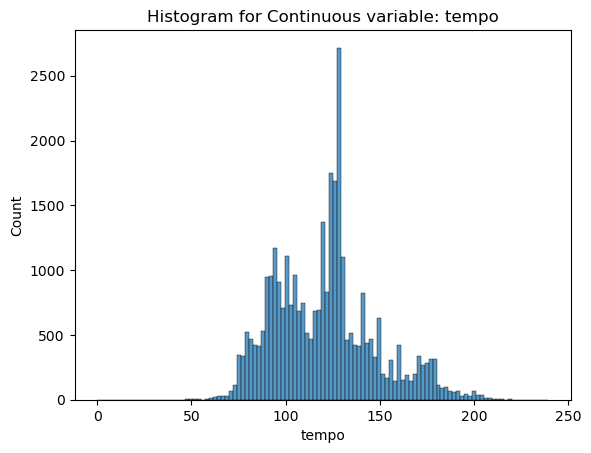

In [85]:
sns.histplot(data=df, x='tempo')
plt.title('Histogram for Continuous variable: tempo')
plt.show()

### Visualizing Categorical-to-categorical relationships

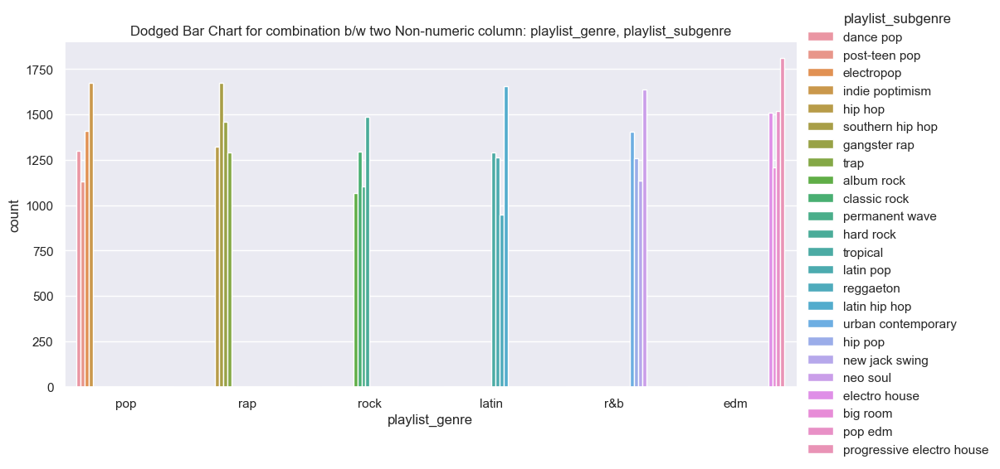

In [124]:
sns.catplot(data=df, x='playlist_genre', hue='playlist_subgenre', kind='count', aspect=2)
plt.title('Dodged Bar Chart for combination b/w two Non-numeric column: playlist_genre, playlist_subgenre')
plt.show()

The above dodged bar chart provides a visual representation of the distribution of subgenres within different primary genres. Since the heights of bars within the genre are different representing various subgenres, we can say that the genre playlist offers a diverse selection of music.

### Visualizing Categorical-to-continuous relationships

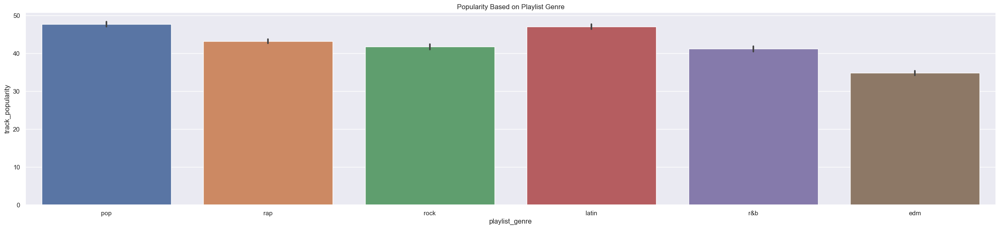

In [143]:
sns.barplot(x='playlist_genre', y='track_popularity', data=df)
plt.title('Popularity Based on Playlist Genre')
plt.show()

We can see that `pop` and `latin` are highly popular whereas `edm` is the least popular. 

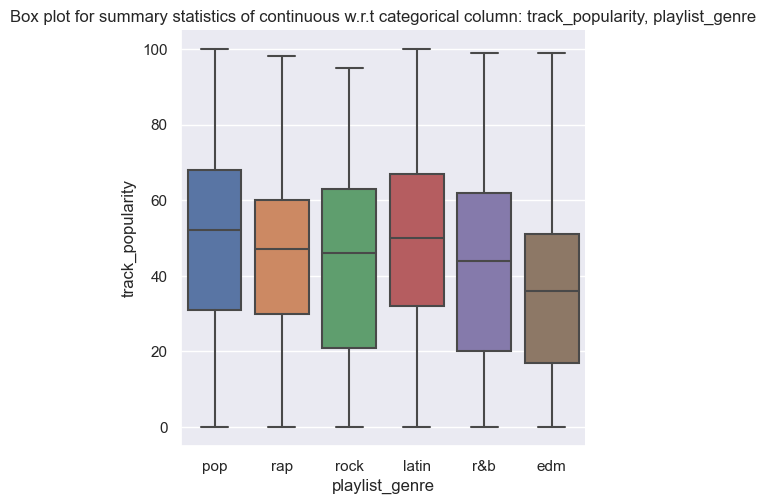

In [136]:
sns.catplot(data=df, x='playlist_genre', y='track_popularity', kind='box')
plt.title('Box plot for summary statistics of continuous w.r.t categorical column: track_popularity, playlist_genre')
plt.show()

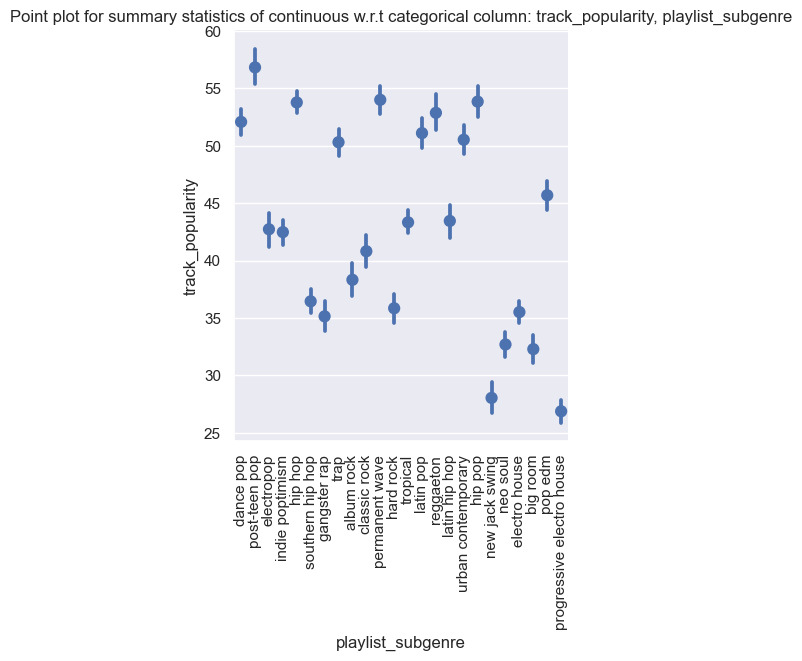

In [137]:
sns.catplot(data=df, x='playlist_subgenre', y='track_popularity', kind='point', join=False)
plt.title('Point plot for summary statistics of continuous w.r.t categorical column: track_popularity, playlist_subgenre')
plt.xticks(rotation=90)
plt.show()

We have summarized the response for each unique value of the categorical inputs `playlist_genre` and `playlist_subgenre` using box and point plots respectively.

### Visualizing Continuous-to-continuous relationships

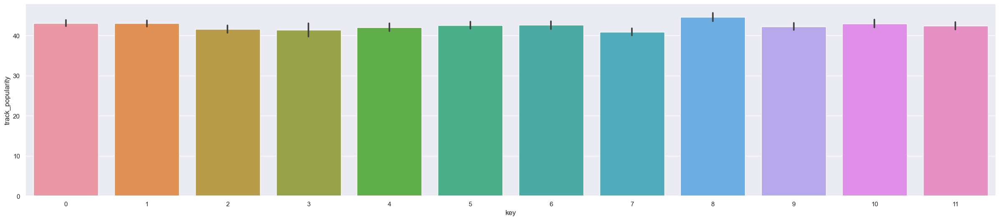

In [186]:
sns.barplot(data=df, x='key', y='track_popularity')
plt.show()

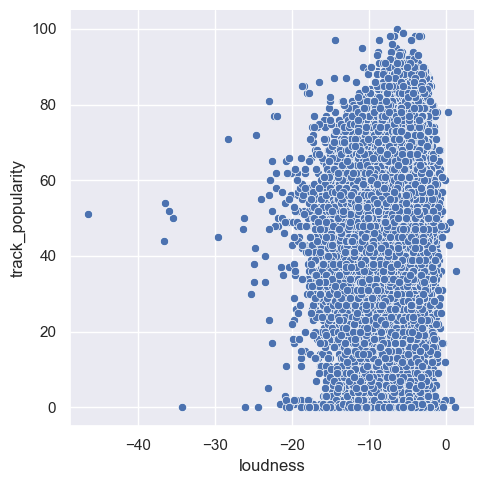

In [179]:
sns.relplot(data=df, x='loudness', y='track_popularity')
plt.show()

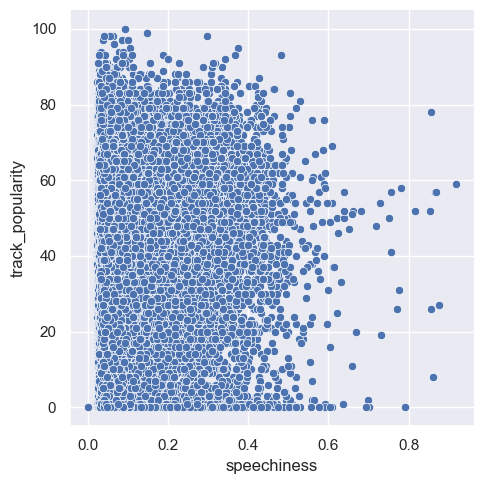

In [189]:
sns.relplot(data=df, x='speechiness', y='track_popularity')
plt.show()

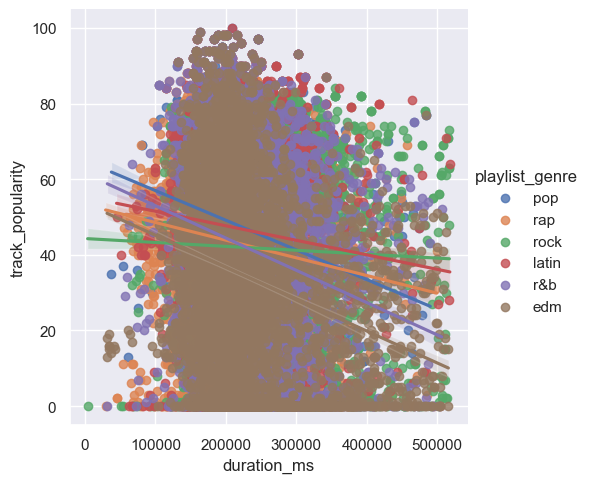

In [190]:
sns.lmplot(data=df, x='duration_ms', y='track_popularity', hue='playlist_genre')
plt.show()

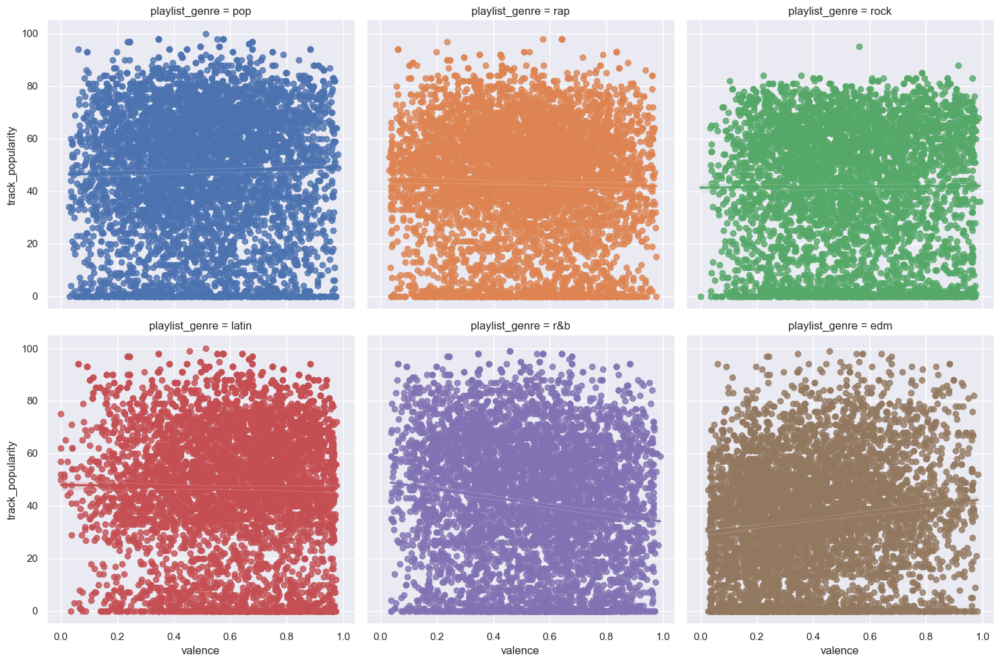

In [178]:
sns.lmplot(data=df, x='valence', y='track_popularity', hue='playlist_genre', col='playlist_genre', col_wrap=3)
plt.show()

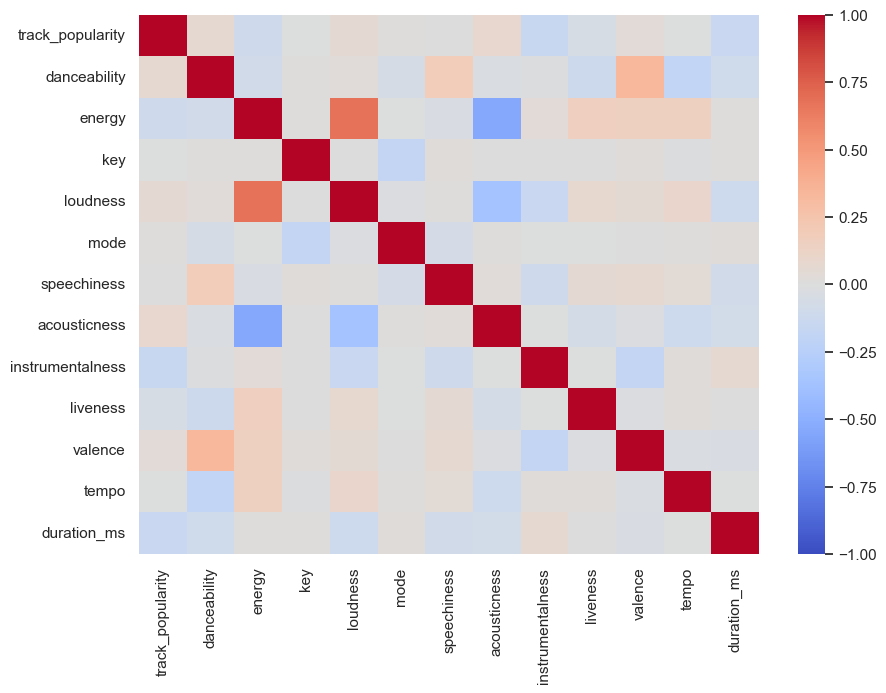

In [291]:
fig, ax = plt.subplots(figsize=(10, 7))
sns.heatmap(data = df.corr(numeric_only=True),
            vmin=-1, vmax=1, center=0,
            cmap='coolwarm',
            ax=ax)
plt.show()

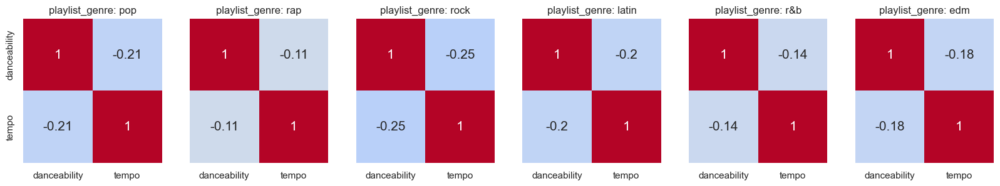

In [191]:
groups = df.playlist_genre.unique().tolist()

corr_per_group = df.loc[ :, ['danceability', 'tempo', 'playlist_genre']].groupby(['playlist_genre']).corr()

fig, axs = plt.subplots(1, len(groups), figsize=(20, 3), sharex=True, sharey=True)

for ix in range(len(groups)):
    sns.heatmap(data = corr_per_group.loc[groups[ix]],
                 vmin=-1, vmax=1, center = 0,
                 cmap='coolwarm', cbar=False,
                 annot=True, annot_kws={'size': 15},
                 ax=axs[ix])
    
    axs[ix].set_title('playlist_genre: %s' % groups[ix] )

plt.show()

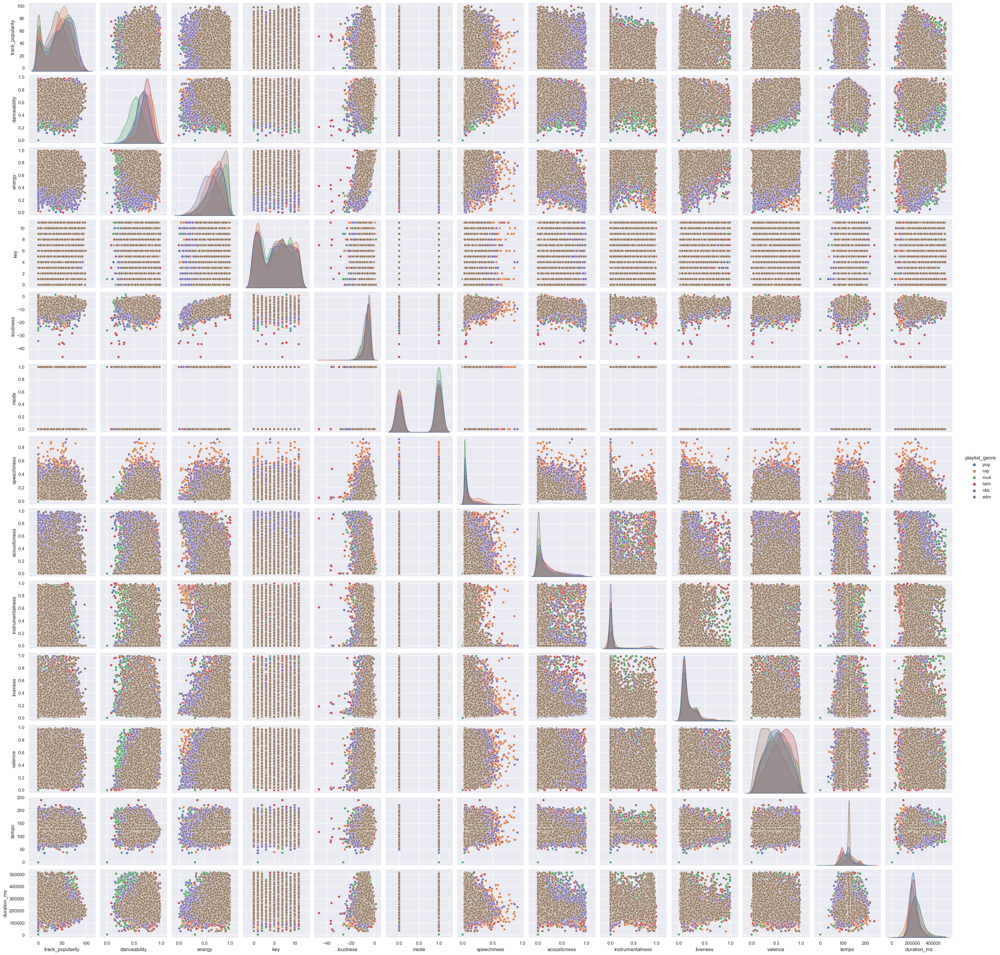

In [192]:
sns.pairplot(data = df, hue='playlist_genre', 
             diag_kws={'common_norm': False})
plt.show()

We have visualized the Continuous-to-continuous relationships between the continuous input and response with bar, scatter, trend plots and heat map (to understand the linear relationship between two continuous columns)

### Part D) Cluster analysis

#### Cluster analysis - select variables

I am using `CONTINUOUS` inputs for the cluster analysis.

In [233]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [292]:
df.isna().sum()

track_id                    0
track_name                  5
track_artist                5
track_popularity            0
track_album_id              0
track_album_name            5
track_album_release_date    0
playlist_name               0
playlist_id                 0
playlist_genre              0
playlist_subgenre           0
danceability                0
energy                      0
key                         0
loudness                    0
mode                        0
speechiness                 0
acousticness                0
instrumentalness            0
liveness                    0
valence                     0
tempo                       0
duration_ms                 0
dtype: int64

We should remove the missing values, although there aren't any in the continuous fields.

In [293]:
df_features = df.select_dtypes('number').copy()

In [294]:
Xdf = StandardScaler().fit_transform(df_features)

In [295]:
Xdf.shape

(32833, 13)

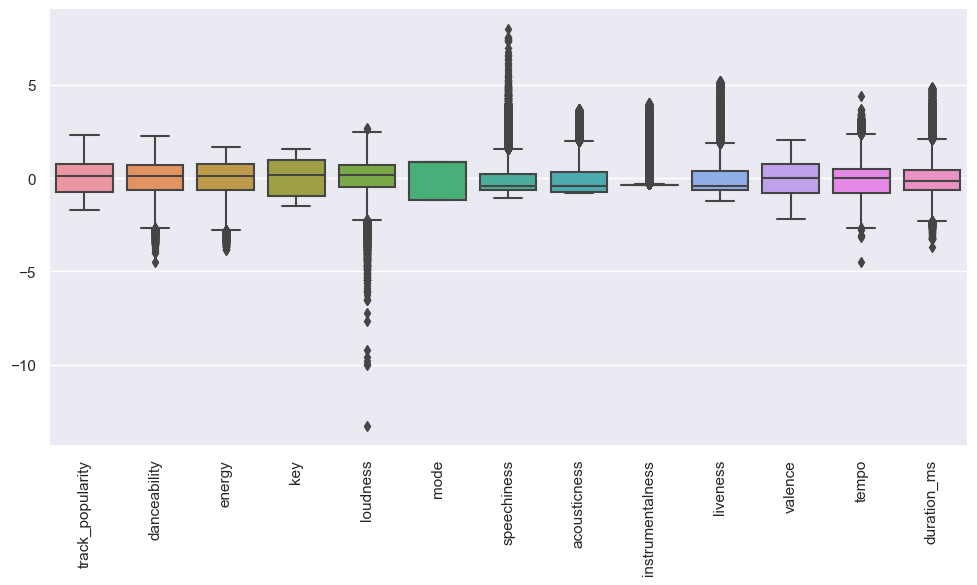

In [296]:
sns.catplot(data=pd.DataFrame(Xdf, columns=df_features.columns), kind='box', aspect=2)
plt.xticks(rotation=90)
plt.show()

I have used `danceability`, `tempo` continuous input variables 

Are the variables you are using highly correlated to each other? Yes, I have implemented the heatmaps in the previous section (Part C)

How should you handle missing values? I have used the StandardScaler method to preprocess and clean the dataframe. I had the same number of observations before and after cleaning, since there were no missing values in the numeric columns of the dataset.

In [297]:
kmeans_2 = KMeans(n_clusters=2, random_state=121, n_init=25, max_iter=500).fit(Xdf)

In [298]:
df['cluster_2'] = kmeans_2.labels_

In [299]:
cluster_2_counts = df['cluster_2'].value_counts()
cluster_2_counts

1    23073
0     9760
Name: cluster_2, dtype: int64

The clusters aren't balanced.

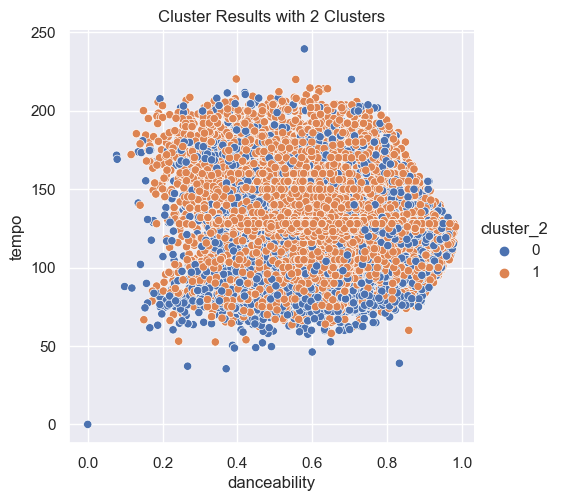

In [303]:
sns.relplot(data=df, x='danceability', y='tempo', hue='cluster_2')
plt.title("Cluster Results with 2 Clusters")
plt.show()

#### Visualize the cluster results using PCA

In [308]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(Xdf)

In [309]:
df['PCA_1'] = X_pca[:, 0]
df['PCA_2'] = X_pca[:, 1]

<Figure size 1200x600 with 0 Axes>

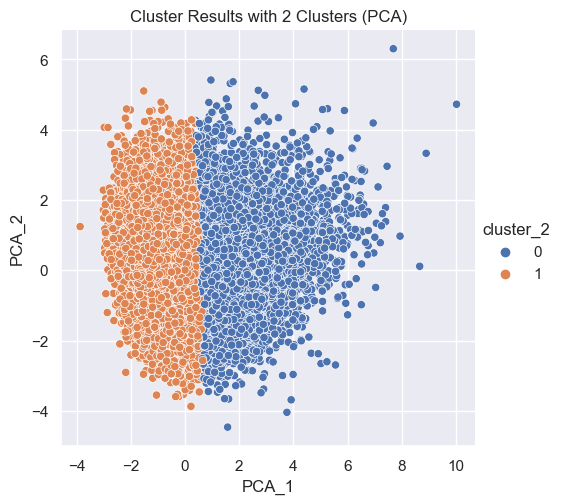

In [310]:
plt.figure(figsize=(12, 6))
sns.relplot(data=df, x='PCA_1', y='PCA_2', hue='cluster_2')
plt.title("Cluster Results with 2 Clusters (PCA)")
plt.show()

#### Identify the optimal number of clusters using Knee Bend

In [311]:
tots_within = []

K = range(1, 31)

for k in K:
    km = KMeans(n_clusters=k, random_state=121, n_init=25, max_iter=500)
    km = km.fit(Xdf)
    
    tots_within.append( km.inertia_ )

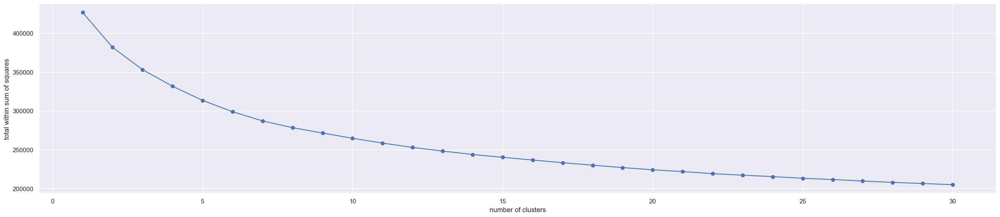

In [312]:
fig, ax = plt.subplots()

ax.plot(K, tots_within, 'bo-')
ax.set_xlabel('number of clusters')
ax.set_ylabel('total within sum of squares')

plt.show()

In [313]:
kmeans_optimal = KMeans(n_clusters=3, random_state=121, n_init=25, max_iter=500).fit(Xdf)

In [314]:
df['cluster_optimal'] = kmeans_optimal.labels_

In [315]:
cluster_optimal_counts = df['cluster_optimal'].value_counts()
cluster_optimal_counts

0    15407
2    11276
1     6150
Name: cluster_optimal, dtype: int64

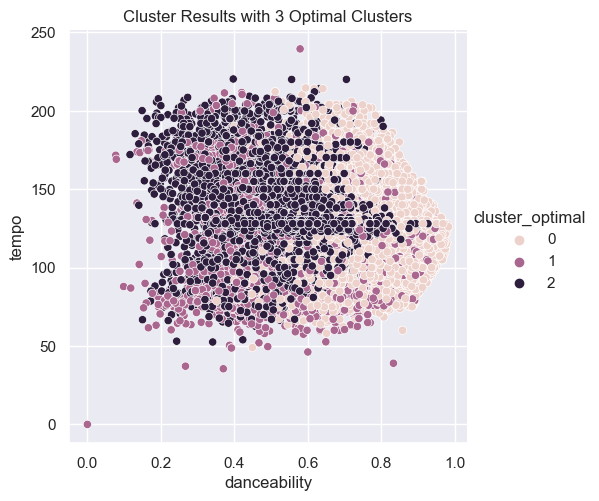

In [316]:
sns.relplot(data=df, x='danceability', y='tempo', hue='cluster_optimal')
plt.title("Cluster Results with 3 Optimal Clusters")
plt.show()

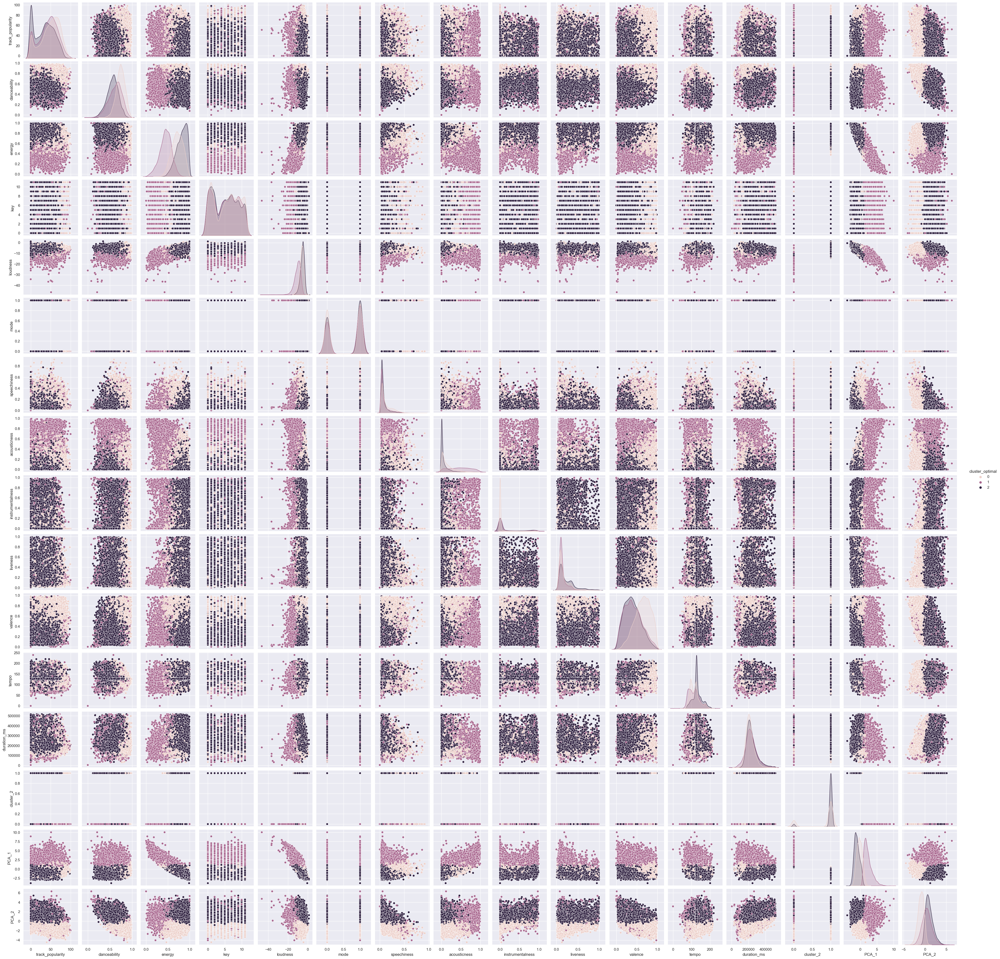

In [317]:
sns.pairplot(data=df, hue='cluster_optimal', diag_kws={'common_norm': False})
plt.show()

Do the OPTIMAL number of clusters ALIGN with CATEGORIES of KNOWN grouping variables in your data? If you are working on a regression problem, are the identified clusters consistent with categories of a categorical input? No, they are not consistent in my case.